In [1]:
from astropy.io import fits
from astropy.wcs import WCS
from astropy.coordinates import SkyCoord
import astropy.units as u
import aplpy

import pandas as pd
import sys
import numpy as np
import matplotlib.pyplot as plt

sys.path.append("/home/cygnus/fujimoto/Cygnus-X_Molecular_Cloud_Analysis/process_tools")
from cut_resize_tools import *
from Astronomy import *

In [2]:
fits_path = "/home/cygnus/fujimoto/Cygnus-X_Molecular_Cloud_Analysis/fits/Cygnus_sp16_vs-40_ve040_dv0.25_12CO_Tmb.fits"
integ_hdu = fits.open("/home/cygnus/fujimoto/Cygnus-X_Molecular_Cloud_Analysis/fits/processed_fits/CygnusX_sp16_120-230_integrate_map.fits")[0]

w_high = WCS(fits_path)
hdu = fits.open(fits_path)[0]
wcs = WCS(integ_hdu.header)

raw_d = hdu.data
header = hdu.header

In [3]:
hdu.data.shape

(320, 1593, 2520)

In [4]:
vsmooth = 5
thresh = 1
sigma = 2
sch_rms = 10
ech_rms = 90
sch_ii = 121
ech_ii = 241
percentile = 99.997
sigma_multiply = None
# width = 60

cut_size_list = [256, 128, 64]
integrate_layer_num = 30
obj_size = 100
maximum_mode = "percentile"

In [5]:
catalogue_path = '/home/cygnus/fujimoto/Cygnus-X_Molecular_Cloud_Analysis/cygnus_infer_catalogue.csv' # 提供されたCSVファイル
catalogue_data = pd.read_csv(catalogue_path)

In [6]:
babble_region_galactic = [] # 変換後の銀河座標を格納するリスト
for index, row in catalogue_data.iterrows():
    RA_min = row['ra_min'] * u.deg # 度単位でUnitsオブジェクトを作成
    RA_max = row['ra_max'] * u.deg
    DEC_min = row['dec_min'] * u.deg
    DEC_max = row['dec_max'] * u.deg

    # 各角の赤経・赤緯座標をSkyCoordオブジェクトとして定義
    # そして銀河座標系に変換
    # RA_min, DEC_min の点
    coord_min_min = SkyCoord(ra=RA_min, dec=DEC_min, frame='icrs').galactic
    # RA_max, DEC_min の点
    coord_max_min = SkyCoord(ra=RA_max, dec=DEC_min, frame='icrs').galactic
    # RA_min, DEC_max の点
    coord_min_max = SkyCoord(ra=RA_min, dec=DEC_max, frame='icrs').galactic
    # RA_max, DEC_max の点
    coord_max_max = SkyCoord(ra=RA_max, dec=DEC_max, frame='icrs').galactic

    # 変換された銀河座標 (l, b) のリストを作成
    babble_region_galactic.append([
        [coord_min_min.l.deg, coord_min_min.b.deg], # 0: L_min, B_min
        [coord_max_min.l.deg, coord_max_min.b.deg], # 1: L_max, B_min
        [coord_min_max.l.deg, coord_min_max.b.deg], # 2: L_min, B_max
        [coord_max_max.l.deg, coord_max_max.b.deg]  # 3: L_max, B_max
    ])
print(f"babble_region_galactic len: {len(babble_region_galactic)}")


# --- babble_region_pix への変換 (修正) ---
# ループ元を babble_region_galactic に変更
babble_region_pix = []
for i in range(len(babble_region_galactic)):
    babble_region = babble_region_galactic[i] # 銀河座標のバブル領域
    region_list = []
    for j in range(len(babble_region)):
        world_coords_list = [list(babble_region[j])] # [L, B] のリスト
        
        # WCS変換。世界座標 (L, B) をピクセル座標に変換
        # origin=0 でPythonの0-based indexに対応
        region_pix_result = wcs.wcs_world2pix(world_coords_list, 0)

        # 変換結果の形状と要素数をチェックする
        if len(region_pix_result) > 0 and len(region_pix_result[0]) == 2:
            region_list.append(region_pix_result[0]) # 期待通り [x, y] を追加
        else:
            print(f"警告: bubble_num={i}, point_idx={j} のWCS変換結果が不正です: {region_pix_result}. NaNで埋めます。")
            region_list.append([np.nan, np.nan]) # NaNで埋めて、後で除外されるようにする

    babble_region_pix.append(region_list)
print(f"babble_region_pix len: {len(babble_region_pix)}")

babble_region_galactic len: 78
babble_region_pix len: 78


In [7]:
cutting_ratio = 2
cutting_data_dic = {}
data_to_cut = raw_d.copy() # raw_d からのコピー

for bubble_num in range(len(babble_region_pix)):
    all_x_coords = [p[0] for p in babble_region_pix[bubble_num]]
    all_y_coords = [p[1] for p in babble_region_pix[bubble_num]]

    # ピクセル座標の最小値と最大値を取得
    # np.min と np.max を使うことで、座標の順序に関わらず正しい矩形領域の境界を取得
    # これにより、x_max_pix < x_min_pix のような逆転を防ぎ、スライス範囲が巨大になるのを防ぐ
    x_min_pix = int(np.floor(np.min(all_x_coords)))
    x_max_pix = int(np.ceil(np.max(all_x_coords)))
    y_min_pix = int(np.floor(np.min(all_y_coords)))
    y_max_pix = int(np.ceil(np.max(all_y_coords)))

    x_center = (x_min_pix + x_max_pix) // 2 
    y_center = (y_min_pix + y_max_pix) // 2
    
    x_range = (x_max_pix - x_min_pix) // 2 * cutting_ratio
    y_range = (y_max_pix - y_min_pix) // 2 * cutting_ratio

    x_min_pix = int(x_center - x_range)
    x_max_pix = int(x_center + x_range)
    y_min_pix = int(y_center - y_range)
    y_max_pix = int(y_center + y_range)

    # 切り出し実行
    # ここでは、np.clip を使用せず、NumPyのスライスが範囲外を0で自動パディングする動作に任せる
    # ただし、x_min_pix/y_min_pix が負になったり、x_max_pix/y_max_pix が大きくなりすぎたりすると、
    # 巨大な配列が生成される可能性がある点に注意（メモリ消費、処理時間）
    cutting_data = data_to_cut[:, y_min_pix:y_max_pix, x_min_pix:x_max_pix]
    pix_cood = (x_min_pix, x_max_pix, y_min_pix, y_max_pix)
    cutting_data_dic[pix_cood] = cutting_data

    # デバッグ用に切り出したデータの形状と範囲を表示してみる
    # print(f"Bubble {bubble_num}: X range [{x_min_pix}, {x_max_pix}], Y range [{y_min_pix}, {y_max_pix}], Shape: {cutting_data.shape}")

In [8]:
deleted_indices = []
filtered_list = [
    data for idx, data in enumerate(cutting_data_dic.items()) 
    if not np.all((data[1] == 0) | np.isnan(data[1]))
    or deleted_indices.append(idx)  # 削除されたインデックスを記録
]

# 削除されたインデックスを表示
print("削除されたデータのインデックス:", deleted_indices)
print("削除された数: ", len(deleted_indices))
print("残ったデータ数: ",len(filtered_list))

削除されたデータのインデックス: [4, 6, 8, 10, 11, 12, 19, 22, 24, 26, 27, 31, 33, 34, 36, 37, 38, 39, 42, 44, 45, 46, 50, 51, 53, 54, 55, 57, 59, 60, 61, 63, 64, 65, 68, 71, 73]
削除された数:  37
残ったデータ数:  41


In [9]:
remove_list = [0, 5, 8, 9, 10, 12, 17, 19, 21, 34]
filtered_list = [data for i, data in enumerate(filtered_list) if i not in remove_list]

In [10]:
print(len(filtered_list))

31


In [11]:
filtered_list[0]

((1376, 1444, 1198, 1262),
 array([[[-3.6603198e+00, -7.0071707e+00, -2.6317546e+00, ...,
          -8.4329075e-01, -1.6491628e+00, -2.3668008e+00],
         [-7.8921616e-01, -1.8074787e+00, -8.8680029e-01, ...,
           1.7246301e+00, -2.0249226e+00, -8.6320772e+00],
         [ 1.0883385e-01,  1.7514718e-01, -3.7409633e-01, ...,
          -3.1391504e+00, -3.0066528e+00, -6.0447669e+00],
         ...,
         [ 1.4046121e-01, -1.8007109e+00, -1.1699625e+00, ...,
           6.6916287e-01,  3.6873155e+00,  7.4312696e+00],
         [ 1.4930763e+00,  2.1601157e+00, -5.2090704e-01, ...,
           3.7637932e+00,  3.7592869e+00,  9.4281960e+00],
         [ 3.7441163e+00,  3.6673315e+00, -7.6201536e-02, ...,
          -5.3299049e+01,  1.6301882e+00,  1.3442915e+01]],
 
        [[-1.5861609e+00, -3.8292229e+00, -2.7229016e+00, ...,
           2.4033227e+00, -2.0523219e+00, -1.4612530e+00],
         [ 1.2175665e+00, -3.0683470e+00, -4.1356478e+00, ...,
           4.7194810e+00, -2.1390407e+0

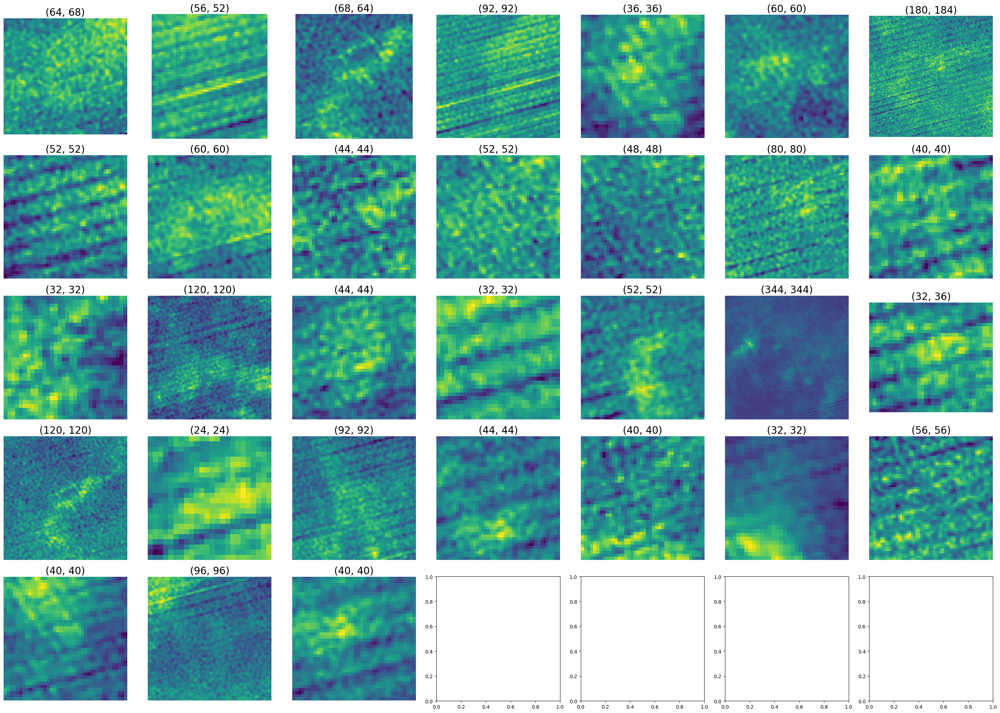

In [12]:
fig, axes = plt.subplots(5, 7, figsize=(4*7, 4*5))
axes = axes.flatten()  # 3x10の軸を1次元配列に変換

for n in range(len(filtered_list)):  # 30個の画像を配置
    data = filtered_list[n][1]
    integ_data = np.nansum(data, axis=0)
    
    axes[n].imshow(integ_data)
    axes[n].axis("off")
    axes[n].set_title((filtered_list[n][1].shape[1], filtered_list[n][1].shape[2]), fontsize=20)

plt.tight_layout()
# plt.savefig("bubbles_zeroing_integ_shape_3.png")
plt.show()

In [13]:
all_map = raw_d.copy()

In [14]:
for pdu in filtered_list:
    pdu = pdu[0]
    x_min, x_max, y_min, y_max = pdu[0], pdu[1], pdu[2], pdu[3]

    # 1. 対象領域をスライスで取得
    region = all_map[:, y_min:y_max, x_min:x_max]
    
    # 2. 領域内でNaNではない要素のマスクを作成
    # np.isnan(region) は NaN の位置が True になる
    # ~ で論理反転させ、NaNで「ない」位置を True にする
    not_nan_mask = ~np.isnan(region)
    
    # 3. マスクがTrueの位置（NaNでない要素）だけを0にする
    region[not_nan_mask] = np.nan

In [15]:
all_map.shape

(320, 1593, 2520)

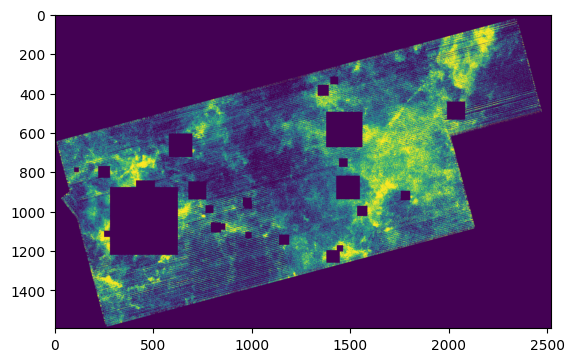

In [16]:
plt.imshow(np.nansum(all_map, axis=0), vmin=0, vmax=500)

In [17]:
a = [1, 1, 1]
b = [2, 2, 2]
a += b
print(a)

[1, 1, 1, 2, 2, 2]


In [ ]:
processed_all_list = []
for pix in cut_size_list:
    print(f"Processing data clipped to {pix} pixels...")

    # Step1: スライス
    cut_data = slide(all_map, pix+4, 4)
    print(f"Number of data clipped to {pix} pixels: {len(cut_data)}")

    cut_data = remove_nan(cut_data)
    print(f"Number of data after deletion: {len(cut_data)}")

    # Step2: 並列前処理
    processed_list = parallel_processing(
                                        function=process_data_segment, 
                                        target=cut_data,
                                        vsmooth=vsmooth,
                                        sch_rms=sch_rms, 
                                        ech_rms=ech_rms,
                                        sch_ii=sch_ii,
                                        ech_ii=ech_ii,
                                        sigma=sigma, 
                                        thresh=thresh, 
                                        integrate_layer_num=integrate_layer_num
                                        )
    processed_all_list += processed_list

Processing data clipped to 256 pixels...
Number of data clipped to 256 pixels: 735
Number of data after deletion: 51
Processing data clipped to 128 pixels...
Number of data clipped to 128 pixels: 3285
Number of data after deletion: 725
Processing data clipped to 64 pixels...
Number of data clipped to 64 pixels: 13050
Number of data after deletion: 4604


In [ ]:
len(processed_all_list)

In [20]:
max_thresh = maximum_value_determination(
                                         mode=maximum_mode, 
                                         data=raw_d, 
                                         vsmooth=vsmooth, 
                                         sch_rms=sch_rms, 
                                         ech_rms=ech_rms, 
                                         sch_ii=sch_ii, 
                                         ech_ii=ech_ii, 
                                         sigma=sigma, 
                                         thresh=thresh, 
                                         integrate_layer_num=integrate_layer_num, 
                                         percentile=percentile
                                        )

======== maximum determination ========
-------- making v_convolution data --------
-------- masking data --------


/usr/local/lib/python3.10/dist-packages/numpy/lib/nanfunctions.py:1872: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


-------- integrating and xy_convolution --------
percentile value is 132.73


In [21]:
conv_resize_list = []
for _data in tqdm(processed_all_list):
    # _data = select_conv(_data, obj_size, obj_sig)
    _data = resize(_data, (obj_size+4, obj_size+4))
    _data = gaussian_filter(_data)
    if maximum_mode in ["percentile", "sigma"]:
        _data = np.clip(_data, a_min=None, a_max=max_thresh)
    conv_resize_list.append(_data)
del processed_all_list

conv_resize_list = normalization_thresh(conv_resize_list, max_thresh)

  0%|          | 0/5380 [00:00<?, ?it/s]

# データ確認

In [22]:
random_num = sorted(np.random.choice(len(conv_resize_list), 20))
print(random_num)

[221, 379, 548, 864, 896, 897, 1733, 2162, 2388, 2525, 2769, 2800, 2835, 4098, 4112, 4493, 4515, 4664, 4685, 5152]


In [23]:
conv_resize_list[0].shape[0]

30

0.0
0.4767939354585957


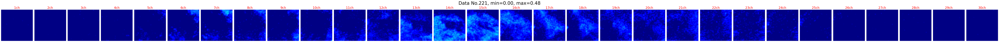

0.0
1.0


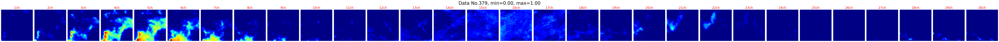

0.0
0.3396452972088395


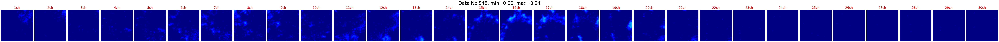

0.0
0.6395355394085644


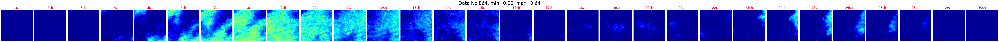

0.0
0.7063547640039687


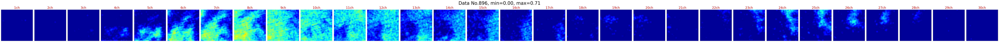

0.0
0.7043925584650907


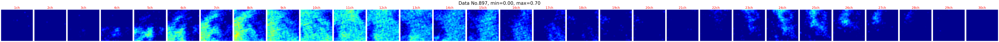

0.0
0.3771376971343262


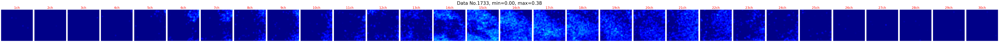

0.0
0.319910444008744


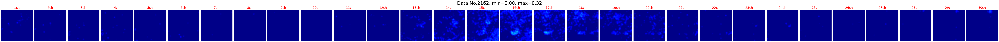

0.0
0.43241560245709565


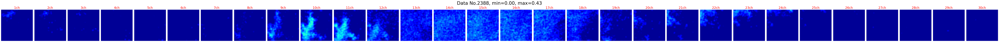

0.0
0.41014902941938386


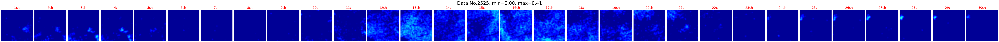

0.0
0.48100466721272733


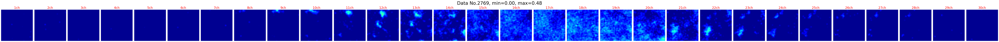

0.0
0.5005345833733109


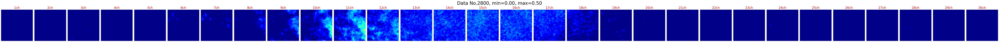

0.0
0.41822157508937113


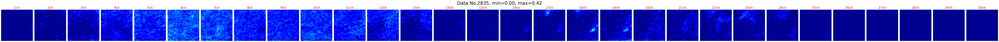

0.0
0.4427614887691746


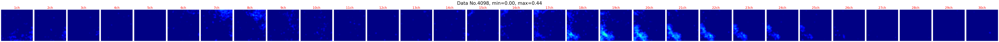

0.0
0.7020189002059609


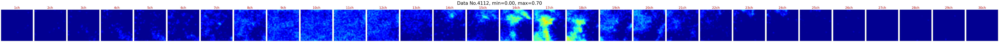

0.0
0.487000254086777


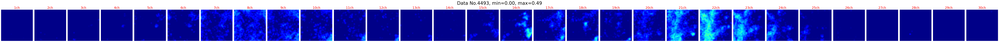

0.0
0.3487874541130907


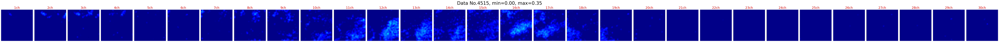

0.0
0.4278966725090236


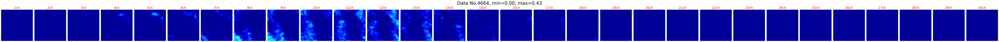

0.0
0.8692987235837303


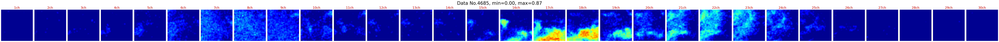

0.0
0.8688798566555048


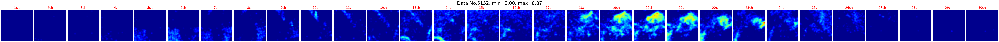

In [24]:
axes_num = conv_resize_list[0].shape[0]

for index in random_num:
    data = conv_resize_list[index]
    print(data.min())
    print(data.max())
    
    fig, axes = plt.subplots(1, axes_num, figsize=(axes_num*3, 1*4))
    for j, data_segment in enumerate(data):
        axes[j].imshow(data_segment, vmin=0, vmax=1, cmap="jet")
        axes[j].axis("off")
        axes[j].set_title(f"{j+1}ch", fontsize=20, color='red')

    fig.suptitle(f"Data No.{index}, min={data.min():.2f}, max={data.max():.2f}", fontsize=30) 
    plt.tight_layout()
    # plt.savefig(f"only_128pix_No{index}.png")
    plt.show()

In [29]:
removal_cut_val = int(len(conv_resize_list)/10)
removal_data = conv_resize_list[removal_cut_val:]
test_data = conv_resize_list[:removal_cut_val]
print(len(conv_resize_list))
print(len(removal_data))
print(len(test_data))

5380
4842
538


# データ保存

In [32]:
np.save("./processed_data/removal_data/non_bubble", removal_data)
np.save("./processed_data/test_data/test_non_bubble", test_data)